# CUDA MEM MGMT

In [1]:
import torch
print(torch.cuda.memory_allocated()/1e9, "GB")
print(torch.cuda.max_memory_allocated()/1e9, "GB")

/content/sam3d-ready/micromamba/envs/sam3d-unified/lib/python3.11/site-packages/torch/cuda/__init__.py:61: FutureWarning: The pynvml package is deprecated. Please install nvidia-ml-py instead. If you did not install pynvml directly, please report this to the maintainers of the package that installed pynvml for you.
  import pynvml  # type: ignore[import]


0.0 GB
0.0 GB


In [2]:
import time
import subprocess
import psutil
from IPython.display import clear_output

try:
    import torch
except Exception:
    torch = None

def show_status():
    try:
        gpu = subprocess.check_output([
            'nvidia-smi',
            '--query-gpu=timestamp,name,memory.used,memory.total,utilization.gpu',
            '--format=csv,noheader,nounits',
        ]).decode().strip()
        print('GPU:', gpu)
    except Exception as exc:
        print('GPU: nvidia-smi unavailable:', exc)

    vm = psutil.virtual_memory()
    print(f'RAM: {vm.used/1e9:.2f} / {vm.total/1e9:.2f} GB ({vm.percent}%)')

    if torch is not None and torch.cuda.is_available():
        alloc = torch.cuda.memory_allocated() / 1e9
        peak = torch.cuda.max_memory_allocated() / 1e9
        print(f'Torch GPU mem: {alloc:.2f} GB (peak {peak:.2f} GB)')

show_status()

# Live refresh (stop with Interrupt):
# while True:
#     clear_output(wait=True)
#     show_status()
#     time.sleep(1)


GPU: 2026/01/12 21:50:17.984, NVIDIA L4, 0, 23034, 0
RAM: 3.00 / 56.86 GB (5.3%)
Torch GPU mem: 0.00 GB (peak 0.00 GB)


In [3]:
# Cell A: 看是谁占了显存
import subprocess
print(subprocess.check_output(["nvidia-smi"]).decode())
print(subprocess.check_output([
    "nvidia-smi",
    "--query-compute-apps=pid,process_name,used_memory",
    "--format=csv"
]).decode())


Mon Jan 12 21:50:24 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA L4                      Off |   00000000:00:03.0 Off |                    0 |
| N/A   66C    P8             18W /   72W |       3MiB /  23034MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# USE DEMO

In [4]:
# Cell 1: Path + CUDA check
import os, sys
from pathlib import Path
import torch

REPO_ROOT = Path("/content/sources/sam-3d-body")
assert REPO_ROOT.exists(), f"Missing: {REPO_ROOT}"
if str(REPO_ROOT) not in sys.path:
    sys.path.insert(0, str(REPO_ROOT))

os.environ.setdefault("PYOPENGL_PLATFORM", "egl")

print("CUDA available:", torch.cuda.is_available())
if not torch.cuda.is_available():
    raise RuntimeError("SAM3D Body inference assumes CUDA (uses recursive_to('cuda')).")

import sam_3d_body
print("sam_3d_body:", sam_3d_body.__version__)


CUDA available: True


sam_3d_body: 1.0.0


/content/sources/sam-3d-body/sam_3d_body/models/heads/mhr_head.py:33: UserWarning: Momentum is not enabled
  warnings.warn("Momentum is not enabled")


In [ ]:
# Cell 2: Input / output paths (sam-3d-body demo image)
from pathlib import Path

REPO_ROOT = Path("/content/sources/sam-3d-body")
image_path = REPO_ROOT / "notebook/images/dancing.jpg"
assert image_path.exists(), f"Missing demo image: {image_path}"
print("image_path:", image_path)

out_dir = REPO_ROOT / "output" / "demo"
out_dir.mkdir(parents=True, exist_ok=True)


image_path: /content/sources/sam-3d-body/notebook/images/dancing.jpg


In [12]:
# Cell 3: Load model from Hugging Face (will download checkpoints)
from sam_3d_body import load_sam_3d_body_hf

repo_id = "facebook/sam-3d-body-vith"  # or "facebook/sam-3d-body-dinov3"
model, model_cfg = load_sam_3d_body_hf(repo_id)


Fetching 5 files:   0%|          | 0/5 [00:00<?, ?it/s]

Loading SAM 3D Body model...


The model and loaded state dict do not match exactly

missing keys in source state_dict: head_pose.hand_pose_comps_ori, head_pose.mhr.face_expressions_model.shape_vectors, head_pose.mhr.pose_correctives_model.pose_dirs_predictor.0.sparse_indices, head_pose.mhr.pose_correctives_model.pose_dirs_predictor.0.sparse_weight, head_pose.mhr.pose_correctives_model.pose_dirs_predictor.2.weight, head_pose.mhr.character_torch.skeleton.joint_translation_offsets, head_pose.mhr.character_torch.skeleton.joint_prerotations, head_pose.mhr.character_torch.skeleton.pmi, head_pose.mhr.character_torch.skeleton.joint_parents, head_pose.mhr.character_torch.mesh.rest_vertices, head_pose.mhr.character_torch.mesh.faces, head_pose.mhr.character_torch.mesh.texcoords, head_pose.mhr.character_torch.mesh.texcoord_faces, head_pose.mhr.character_torch.parameter_transform.parameter_transform, head_pose.mhr.character_torch.parameter_transform.pose_parameters, head_pose.mhr.character_torch.parameter_transform.rigid_parame

In [13]:
# Cell 4: Build estimator (no detector/segmentor/fov by default)
from sam_3d_body import SAM3DBodyEstimator

estimator = SAM3DBodyEstimator(model, model_cfg)


No human detector is used...
Mask-condition inference is not supported...
No FOV estimator... Using the default FOV!


In [14]:
# Cell 5: Run inference
outputs = estimator.process_one_image(str(image_path), use_mask=False)
print("num_people:", len(outputs))


num_people: 1


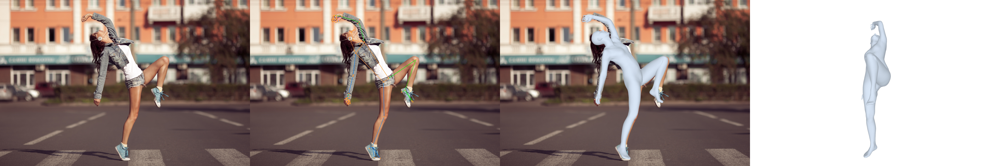

saved: /content/sources/sam-3d-body/output/demo/dancing_sam3d_body.jpg


In [17]:
# Cell 6: Render + save + show
import cv2
import numpy as np
from tools.vis_utils import visualize_sample_together
from PIL import Image
from IPython.display import display

img_bgr = cv2.imread(str(image_path))
rend = visualize_sample_together(img_bgr, outputs, estimator.faces)
out_path = out_dir / f"{image_path.stem}_sam3d_body.jpg"
cv2.imwrite(str(out_path), rend.astype(np.uint8))
display(Image.open(out_path))
print("saved:", out_path)


In [ ]:
# Export + interactive preview (single person)
import numpy as np
import plotly.graph_objects as go
import plotly.io as pio
import trimesh
from pathlib import Path

pio.renderers.default = "notebook_connected"

person_idx = 0  # change if multiple people
out = outputs[person_idx]

# Mesh in camera space (same as visualization)
verts = out["pred_vertices"] + out["pred_cam_t"][None, :]
faces = estimator.faces

# Save mesh
out_mesh = Path("/content/sources/sam-3d-body/output/demo") / f"{image_path.stem}_person{person_idx}.obj"
trimesh.Trimesh(vertices=verts, faces=faces, process=False).export(out_mesh)
print("saved mesh:", out_mesh)

# Interactive preview
fig = go.Figure(data=[go.Mesh3d(
    x=verts[:, 0], y=verts[:, 1], z=verts[:, 2],
    i=faces[:, 0], j=faces[:, 1], k=faces[:, 2],
    color="lightblue", opacity=1.0
)])
fig.update_layout(scene_aspectmode="data")
fig.show(config={"scrollZoom": True})


In [ ]:
# 单视图投影 + 近似可见性 + 相机视角
import numpy as np
import cv2
import trimesh
import plotly.graph_objects as go
import plotly.io as pio

pio.renderers.default = "notebook_connected"

person_idx = 0
out = outputs[person_idx]
verts = out["pred_vertices"].copy()
faces = estimator.faces
cam_t = out["pred_cam_t"]
f = float(out["focal_length"])

img = cv2.cvtColor(cv2.imread(str(image_path)), cv2.COLOR_BGR2RGB)
H, W = img.shape[:2]
cx, cy = W / 2.0, H / 2.0

# camera-space (与 repo 投影一致)
verts_cam = verts + cam_t[None, :]
z = verts_cam[:, 2]

# 可选翻转（如果方向不对）
flip_x = False
flip_y = False

u = (verts_cam[:, 0] / z) * f + cx
v = (verts_cam[:, 1] / z) * f + cy
if flip_x:
    u = (W - 1) - u
if flip_y:
    v = (H - 1) - v

u = np.round(u).astype(np.int32)
v = np.round(v).astype(np.int32)

valid = z > 1e-6
in_bounds = valid & (u >= 0) & (u < W) & (v >= 0) & (v < H)

# 顶点级 z-buffer（近似遮挡）
depth = np.full((H, W), np.inf, dtype=np.float32)
uu = u[in_bounds]; vv = v[in_bounds]; zz = z[in_bounds]
np.minimum.at(depth, (vv, uu), zz)

depth_eps = 1e-2
visible = np.zeros(len(verts_cam), dtype=bool)
visible[in_bounds] = zz <= (depth[vv, uu] + depth_eps)

# 法线朝向过滤（进一步去掉背面）
mesh = trimesh.Trimesh(vertices=verts_cam, faces=faces, process=False)
vn = mesh.vertex_normals
view_dir = -verts_cam
view_dir /= (np.linalg.norm(view_dir, axis=1, keepdims=True) + 1e-8)
front = (vn * view_dir).sum(axis=1) > 0
visible &= front

colors = np.full((len(verts_cam), 3), 128, dtype=np.uint8)
colors[visible] = img[v[visible], u[visible]]

fig = go.Figure(data=[go.Mesh3d(
    x=verts_cam[:, 0], y=verts_cam[:, 1], z=verts_cam[:, 2],
    i=faces[:, 0], j=faces[:, 1], k=faces[:, 2],
    vertexcolor=colors, opacity=1.0
)])
fig.update_layout(
    scene=dict(
        aspectmode="data",
        camera=dict(
            eye=dict(x=0, y=0, z=-2.0),  # 相机视角；反了就改成 +2.0
            up=dict(x=0, y=-1, z=0)
        )
    )
)
fig.show(config={"scrollZoom": True})


In [ ]:
# 全部顶点对称着色（不做可见性过滤）
import numpy as np
import cv2
import plotly.graph_objects as go
import plotly.io as pio

pio.renderers.default = "notebook_connected"

person_idx = 0
out = outputs[person_idx]
verts = out["pred_vertices"]
faces = estimator.faces
cam_t = out["pred_cam_t"]
f = float(out["focal_length"])

img = cv2.cvtColor(cv2.imread(str(image_path)), cv2.COLOR_BGR2RGB)
H, W = img.shape[:2]
cx, cy = W / 2.0, H / 2.0

verts_cam = verts + cam_t[None, :]
z = verts_cam[:, 2]

u = (verts_cam[:, 0] / z) * f + cx
v = (verts_cam[:, 1] / z) * f + cy
u = np.round(u).astype(np.int32)
v = np.round(v).astype(np.int32)

in_bounds = (z > 1e-6) & (u >= 0) & (u < W) & (v >= 0) & (v < H)

colors = np.full((len(verts_cam), 3), 128, dtype=np.uint8)
colors[in_bounds] = img[v[in_bounds], u[in_bounds]]

fig = go.Figure(data=[go.Mesh3d(
    x=verts_cam[:, 0], y=verts_cam[:, 1], z=verts_cam[:, 2],
    i=faces[:, 0], j=faces[:, 1], k=faces[:, 2],
    vertexcolor=colors, opacity=1.0
)])
fig.update_layout(
    scene=dict(
        aspectmode="data",
        camera=dict(eye=dict(x=0, y=0, z=-2.0), up=dict(x=0, y=-1, z=0))
    )
)
fig.show(config={"scrollZoom": True})


# EXAMPLE SEG

## ONE MASK

In [31]:
from pathlib import Path

image_path = Path("/content/sam3d-ready/notebook/example/jazz-dance/image.jpg")
assert image_path.exists(), f"Missing: {image_path}"

out_dir = image_path.parent
mask_path = out_dir / "mask.png"

prompt = "person"  # change if needed


In [32]:
import torch
from sam3.model_builder import build_sam3_image_model
from sam3.model.sam3_image_processor import Sam3Processor

device = "cuda" if torch.cuda.is_available() else "cpu"
model = build_sam3_image_model(device=device)
processor = Sam3Processor(model)


In [33]:
import numpy as np
from PIL import Image

combine_all = False  # True = merge all masks into one

image = Image.open(image_path).convert("RGB")
state = processor.set_image(image)
output = processor.set_text_prompt(state=state, prompt=prompt)

masks = output["masks"]
scores = output.get("scores")

# normalize mask shape to [N, H, W]
if masks.ndim == 4:
    masks = masks[:, 0]

if combine_all:
    mask = masks.max(dim=0).values
    score_msg = "combined"
else:
    idx = int(scores.argmax().item()) if scores is not None else 0
    mask = masks[idx]
    score_msg = float(scores[idx]) if scores is not None else "n/a"

mask = mask.float().cpu().numpy()
mask_bin = (mask > 0).astype(np.uint8) * 255
Image.fromarray(mask_bin).save(mask_path)
print("mask saved:", mask_path, "score:", score_msg)


mask saved: /content/sam3d-ready/notebook/example/jazz-dance/mask.png score: 0.9218029975891113


In [ ]:
import numpy as np
from PIL import Image
from IPython.display import display

orig = Image.open(image_path).convert("RGB")
mask_img = Image.open(mask_path).convert("L")

orig_np = np.array(orig)
mask_np = np.array(mask_img) > 0

overlay = orig_np.copy()
overlay[mask_np] = (overlay[mask_np] * 0.4 + np.array([255, 0, 0]) * 0.6).astype(np.uint8)
overlay = Image.fromarray(overlay)

w, h = orig.size
side = Image.new("RGB", (w * 2, h))
side.paste(orig, (0, 0))
side.paste(overlay, (w, 0))

display(side)


## Mask ALL

Mask candidates: 2
Top by score:
  idx=00 score=0.922 area=524123 (9.50%)
  idx=01 score=0.915 area=870337 (15.77%)

IoU among top candidates:
  idx 00:  1.00 0.00
  idx 01: 0.00  1.00

Selected masks: [1, 0]
saved: /content/sam3d-ready/notebook/example/jazz-dance/mask_0.png (score=0.915, area=870337)
saved: /content/sam3d-ready/notebook/example/jazz-dance/mask_1.png (score=0.922, area=524123)


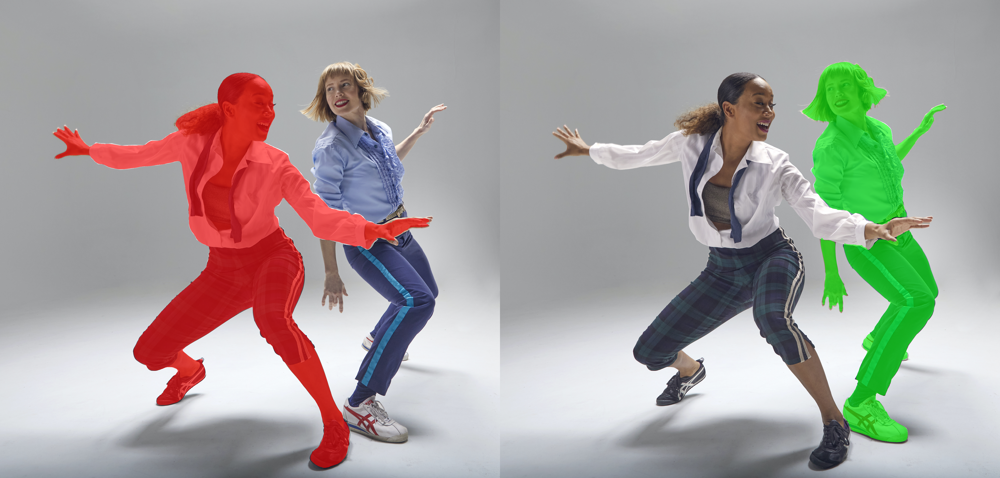

In [36]:
# Two-person masks with stats + IoU + side-by-side preview
import torch
import numpy as np
from PIL import Image
from IPython.display import display

image = Image.open(image_path).convert("RGB")
state = processor.set_image(image)
output = processor.set_text_prompt(state=state, prompt="person")

masks = output["masks"]
scores = output.get("scores", None)

# normalize to torch CPU [N, H, W]
if isinstance(masks, np.ndarray):
    masks = torch.from_numpy(masks)
if masks.ndim == 4:
    masks = masks[:, 0]
masks = masks.float().cpu()

if scores is None:
    scores = torch.ones(len(masks))
elif isinstance(scores, np.ndarray):
    scores = torch.from_numpy(scores)
scores = scores.float().cpu()

N = len(masks)
H, W = masks.shape[-2:]
print(f"Mask candidates: {N}")

if N == 0:
    raise RuntimeError("No masks returned by SAM3")

masks_bin = masks > 0
areas = masks_bin.sum(dim=(1, 2))  # pixels
area_ratio = areas / float(H * W)

# top-K by score for quick inspection
top_k = min(8, N)
order_by_score = torch.argsort(scores, descending=True)
print("Top by score:")
for idx in order_by_score[:top_k]:
    print(f"  idx={int(idx):02d} score={scores[idx]:.3f} area={int(areas[idx])} ({area_ratio[idx]*100:.2f}%)")

# IoU table for top-K
def iou(a, b):
    inter = (a & b).sum().float()
    union = (a | b).sum().float() + 1e-6
    return (inter / union).item()

print("\nIoU among top candidates:")
top_idx = order_by_score[:top_k].tolist()
for i in range(top_k):
    row = []
    for j in range(top_k):
        if i == j:
            row.append(" 1.00")
        else:
            row.append(f"{iou(masks_bin[top_idx[i]], masks_bin[top_idx[j]]):.2f}")
    print(f"  idx {top_idx[i]:02d}: " + " ".join(row))

# dedupe by IoU, then keep largest two
score_thresh = 0.4
area_thresh = 0.01 * H * W
iou_thresh = 0.9

keep = []
for i in order_by_score.tolist():
    if scores[i] < score_thresh or areas[i] < area_thresh:
        continue
    ok = True
    for j in keep:
        if iou(masks_bin[i], masks_bin[j]) > iou_thresh:
            ok = False
            break
    if ok:
        keep.append(i)

keep = sorted(keep, key=lambda i: areas[i].item(), reverse=True)[:2]
print("\nSelected masks:", keep)

# save + side-by-side preview
out_dir = image_path.parent
orig_np = np.array(image)

def overlay_mask(img_np, mask_np, color):
    out = img_np.copy()
    out[mask_np] = (out[mask_np] * 0.4 + np.array(color) * 0.6).astype(np.uint8)
    return out

overlays = []
colors = [(255, 0, 0), (0, 255, 0)]
for k, idx in enumerate(keep):
    mask_np = masks_bin[idx].numpy()
    mask_path = out_dir / f"mask_{k}.png"
    Image.fromarray((mask_np.astype(np.uint8) * 255)).save(mask_path)
    overlays.append(Image.fromarray(overlay_mask(orig_np, mask_np, colors[k])))
    print("saved:", mask_path, f"(score={scores[idx]:.3f}, area={int(areas[idx])})")

if len(overlays) == 2:
    w, h = overlays[0].size
    side = Image.new("RGB", (w * 2, h))
    side.paste(overlays[0], (0, 0))
    side.paste(overlays[1], (w, 0))
    display(side)
elif len(overlays) == 1:
    display(overlays[0])
else:
    print("No valid masks found. Lower score_thresh/area_thresh.")


In [37]:
import numpy as np
from PIL import Image

mask_paths = [
    image_path.parent / "mask_0.png",
    image_path.parent / "mask_1.png",
]

masks = []
bboxes = []
for p in mask_paths:
    m = np.array(Image.open(p).convert("L")) > 0
    if m.sum() == 0:
        print("empty mask:", p)
        continue
    ys, xs = np.where(m)
    x1, y1, x2, y2 = xs.min(), ys.min(), xs.max(), ys.max()
    bboxes.append([x1, y1, x2, y2])
    masks.append(m.astype(np.uint8))

masks = np.stack(masks)           # [N, H, W]
bboxes = np.array(bboxes, dtype=np.float32)  # [N, 4]

print("masks shape:", masks.shape, "bboxes shape:", bboxes.shape)
print("bboxes:", bboxes)


masks shape: (2, 2299, 2400) bboxes shape: (2, 4)
bboxes: [[ 257.  350. 2059. 2249.]
 [1451.  298. 2141. 2126.]]


In [40]:
from sam_3d_body import load_sam_3d_body_hf, SAM3DBodyEstimator

repo_id = "facebook/sam-3d-body-vith"  # or "facebook/sam-3d-body-dinov3"
model, model_cfg = load_sam_3d_body_hf(repo_id)
estimator = SAM3DBodyEstimator(model, model_cfg)


Fetching 5 files:   0%|          | 0/5 [00:00<?, ?it/s]

Loading SAM 3D Body model...



missing keys in source state_dict: head_pose.hand_pose_comps_ori, head_pose.mhr.face_expressions_model.shape_vectors, head_pose.mhr.pose_correctives_model.pose_dirs_predictor.0.sparse_indices, head_pose.mhr.pose_correctives_model.pose_dirs_predictor.0.sparse_weight, head_pose.mhr.pose_correctives_model.pose_dirs_predictor.2.weight, head_pose.mhr.character_torch.skeleton.joint_translation_offsets, head_pose.mhr.character_torch.skeleton.joint_prerotations, head_pose.mhr.character_torch.skeleton.pmi, head_pose.mhr.character_torch.skeleton.joint_parents, head_pose.mhr.character_torch.mesh.rest_vertices, head_pose.mhr.character_torch.mesh.faces, head_pose.mhr.character_torch.mesh.texcoords, head_pose.mhr.character_torch.mesh.texcoord_faces, head_pose.mhr.character_torch.parameter_transform.parameter_transform, head_pose.mhr.character_torch.parameter_transform.pose_parameters, head_pose.mhr.character_torch.parameter_transform.rigid_parameters, head_pose.mhr.character_torch.parameter_transfo

No human detector is used...
Mask-condition inference is not supported...
No FOV estimator... Using the default FOV!


In [41]:
outputs = estimator.process_one_image(
    str(image_path),
    bboxes=bboxes,
    masks=masks,
    use_mask=True
)
print("num_people:", len(outputs))


Using provided masks: (2, 2299, 2400)


num_people: 2


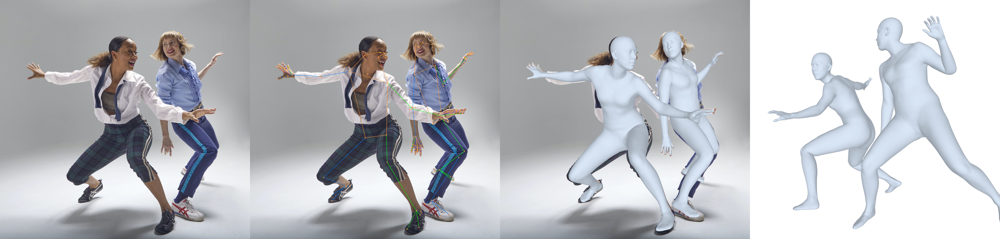

saved: /content/sam3d-ready/notebook/example/jazz-dance/image_sam3d_body_masked.jpg


In [42]:
import cv2
import numpy as np
from tools.vis_utils import visualize_sample_together
from PIL import Image
from IPython.display import display

img_bgr = cv2.imread(str(image_path))
rend = visualize_sample_together(img_bgr, outputs, estimator.faces)

out_path = image_path.parent / f"{image_path.stem}_sam3d_body_masked.jpg"
cv2.imwrite(str(out_path), rend.astype(np.uint8))
display(Image.open(out_path))
print("saved:", out_path)


# Clear vram

In [30]:
import gc, os, psutil, subprocess

try:
    import torch
except Exception:
    torch = None

def mem():
    cpu = psutil.Process(os.getpid()).memory_info().rss / (1024**3)
    try:
        used, total = subprocess.check_output(
            ["nvidia-smi","--query-gpu=memory.used,memory.total","--format=csv,noheader,nounits"]
        ).decode().strip().split(",")
        gpu = (int(used), int(total))
    except Exception:
        gpu = (None, None)
    return cpu, gpu

cpu_before, (gpu_before, gpu_total) = mem()

# 删除 notebook 里可能存在的大对象
for name in [
    # 模型 / 推理
    "model", "model_cfg", "estimator", "outputs",
    # 图像/渲染
    "img_bgr", "rend", "mesh", "scene", "renderer",
    # 交互可视化
    "fig", "verts", "faces", "colors",
]:
    if name in globals():
        del globals()[name]

gc.collect()

if torch is not None and torch.cuda.is_available():
    torch.cuda.synchronize()
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()
    torch.cuda.reset_peak_memory_stats()
    torch.cuda.reset_accumulated_memory_stats()

cpu_after, (gpu_after, _) = mem()

print(f"CPU RSS: {cpu_before:.2f} GB -> {cpu_after:.2f} GB")
print(f"GPU mem: {gpu_before} MiB -> {gpu_after} MiB (total {gpu_total} MiB)")


CPU RSS: 5.10 GB -> 5.10 GB
GPU mem: 261 MiB -> 261 MiB (total 23034 MiB)


In [29]:
# Explicit cleanup for the model cell you mentioned
import gc
import torch

for name in ["model", "model_cfg", "estimator", "outputs"]:
    if name in globals():
        del globals()[name]

gc.collect()
torch.cuda.empty_cache()
torch.cuda.ipc_collect()
